# InPatient Data

In [75]:
import pandas as pd
import numpy as np

benefit = pd.read_csv("./data/Train_Beneficiarydata-1542865627584.csv")

inpatient = pd.read_csv("./data/Train_Inpatientdata-1542865627584.csv")

result = pd.read_csv("./data/Train-1542865627584.csv")

StateCode = pd.read_csv("./data/StateCodes.csv")

print(len(benefit))
print(len(inpatient))
print(len(result))

benefit.head()

138556
40474
5410


,BeneID,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,...,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,1943-01-01,NaN,1,1,0,39,230,12,12,...,1,1,1,2,1,1,36000,3204,60,70
1,BENE11002,1936-09-01,NaN,2,1,0,39,280,12,12,...,2,2,2,2,2,2,0,0,30,50
2,BENE11003,1936-08-01,NaN,1,1,0,52,590,12,12,...,2,2,1,2,2,2,0,0,90,40
3,BENE11004,1922-07-01,NaN,1,1,0,39,270,12,12,...,2,1,1,1,1,2,0,0,1810,760
4,BENE11005,1935-09-01,NaN,1,1,0,24,680,12,12,...,2,1,2,2,2,2,0,0,1790,1200


In [76]:
inpatient.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,2724,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,NaN,NaN,NaN,NaN,7092.0,NaN,NaN,NaN,NaN,NaN
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,BENE11011,CLM38412,2009-02-14,2009-02-22,PRV52405,5000,PHY369659,PHY392961,PHY349768,2009-02-14,...,25062,40390,4019,NaN,331.0,NaN,NaN,NaN,NaN,NaN
4,BENE11014,CLM63689,2009-08-13,2009-08-30,PRV56614,10000,PHY379376,PHY398258,NaN,2009-08-13,...,5119,29620,20300,NaN,3893.0,NaN,NaN,NaN,NaN,NaN


In [77]:
result.head()

,Provider,PotentialFraud
0,PRV51001,No
1,PRV51003,Yes
2,PRV51004,No
3,PRV51005,Yes
4,PRV51007,No


In [78]:
benefit.dtypes

BeneID                      object
DOB                         object
DOD                         object
Gender                       int64
Race                         int64
                             ...  
ChronicCond_stroke           int64
IPAnnualReimbursementAmt     int64
IPAnnualDeductibleAmt        int64
OPAnnualReimbursementAmt     int64
OPAnnualDeductibleAmt        int64
Length: 25, dtype: object

In [79]:
result_inpatient = pd.merge(inpatient, result, how='inner', on=['Provider'])
result_inpatient.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,PotentialFraud
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
1,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,2753,E9305,NaN,7769.0,5849.0,NaN,NaN,NaN,NaN,Yes
2,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,43812,4019,NaN,9338.0,NaN,NaN,NaN,NaN,NaN,Yes
3,BENE22934,CLM73394,2009-10-25,2009-10-29,PRV55912,13000,PHY390614,PHY323689,PHY363291,2009-10-25,...,NaN,NaN,NaN,8154.0,NaN,NaN,NaN,NaN,NaN,Yes
4,BENE24402,CLM32911,2009-01-08,2009-01-12,PRV55912,3000,PHY380413,PHY432598,NaN,2009-01-08,...,NaN,NaN,NaN,8543.0,NaN,NaN,NaN,NaN,NaN,Yes


In [80]:
result_inpatient_benefit = pd.merge(result_inpatient,benefit, how='inner', on=['BeneID'])
print(len(result_inpatient_benefit))
print(result_inpatient_benefit.dtypes)
result_inpatient_benefit.head()

40474
BeneID                      object
ClaimID                     object
ClaimStartDt                object
ClaimEndDt                  object
Provider                    object
                             ...  
ChronicCond_stroke           int64
IPAnnualReimbursementAmt     int64
IPAnnualDeductibleAmt        int64
OPAnnualReimbursementAmt     int64
OPAnnualDeductibleAmt        int64
Length: 55, dtype: object


,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,1,1,1,2,1,1,36000,3204,60,70
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,1,1,1,2,1,1,36000,3204,60,70
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,1,1,1,2,1,1,36000,3204,60,70
3,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,2,2,1,2,2,2,19000,1068,100,20
4,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,2,2,1,1,2,2,17000,1068,1050,540


In [81]:
result_inpatient_benefit.describe

<bound method NDFrame.describe of            BeneID   ClaimID ClaimStartDt  ClaimEndDt  Provider  \
0       BENE11001  CLM46614   2009-04-12  2009-04-18  PRV55912   
1       BENE11001  CLM66048   2009-08-31  2009-09-02  PRV55907   
2       BENE11001  CLM68358   2009-09-17  2009-09-20  PRV56046   
3       BENE17521  CLM34721   2009-01-20  2009-02-01  PRV55912   
4       BENE21718  CLM72336   2009-10-17  2009-11-04  PRV55912   
...           ...       ...          ...         ...       ...   
40469  BENE152832  CLM49682   2009-05-03  2009-05-06  PRV54063   
40470  BENE153373  CLM53102   2009-05-28  2009-06-02  PRV54932   
40471  BENE154457  CLM35582   2009-01-26  2009-01-29  PRV51424   
40472  BENE156872  CLM67045   2009-09-06  2009-09-13  PRV51572   
40473  BENE158281  CLM35143   2009-01-23  2009-01-23  PRV56485   

       InscClaimAmtReimbursed AttendingPhysician OperatingPhysician  \
0                       26000          PHY390922                NaN   
1                        5000  

In [82]:
result_inpatient_benefit.RenalDiseaseIndicator  # There are 0 and Y ) for No and Y for yes

0        0
1        0
2        0
3        0
4        0
        ..
40469    0
40470    0
40471    0
40472    Y
40473    Y
Name: RenalDiseaseIndicator, Length: 40474, dtype: object

In [83]:
result_inpatient_benefit['ClmProcedureCode_1']
#change 2s to 0s for Nos in all data column
result_inpatient_benefit = result_inpatient_benefit.replace({'ChronicCond_Alzheimer': 2, 'ChronicCond_Heartfailure': 2, 'ChronicCond_KidneyDisease': 2,
                           'ChronicCond_Cancer': 2, 'ChronicCond_ObstrPulmonary': 2, 'ChronicCond_Depression': 2, 
                           'ChronicCond_Diabetes': 2, 'ChronicCond_IschemicHeart': 2, 'ChronicCond_Osteoporasis': 2, 
                           'ChronicCond_rheumatoidarthritis': 2, 'ChronicCond_stroke': 2 }, 0)

result_inpatient_benefit = result_inpatient_benefit.replace({'RenalDiseaseIndicator': 'Y'}, 1)


In [84]:
print(len(benefit))
benefit.isna().sum()  
# There are 137135 out of 138556 beneficiary in general that are still alive.

138556


BeneID                           0
DOB                              0
DOD                         137135
Gender                           0
Race                             0
                             ...  
ChronicCond_stroke               0
IPAnnualReimbursementAmt         0
IPAnnualDeductibleAmt            0
OPAnnualReimbursementAmt         0
OPAnnualDeductibleAmt            0
Length: 25, dtype: int64

In [136]:
StateCode

,Name,FIPS State Numeric Code,Official USPS Code,State
0,Alabama,1,AL,1
1,Alaska,2,AK,2
2,Arizona,4,AZ,4
3,Arkansas,5,AR,5
4,California,6,CA,6
5,Colorado,8,CO,8
6,Connecticut,9,CT,9
7,Delaware,10,DE,10
8,District of Columbia,11,DC,11
9,Florida,12,FL,12


In [ ]:
StateCode = pd.read_csv("./data/StateCodes.csv")
#StateCode.rename(columns={"FIPS State Numeric Code": "State"})
StateCode['State'] = StateCode['FIPS State Numeric Code']
StateCode["State's Abbr"] = StateCode['FIPS State Numeric Code']
StateCode = StateCode['Name',"State's Abbr",'State']


result_inpatient_benefit = pd.merge(result_inpatient_benefit,StateCode, how='inner', on=['State'])

In [85]:
print(len(result_inpatient_benefit))
result_inpatient_benefit.isna().sum()
# There are 40156 out of 40474 beneficiary that are inpatient that are still alive.

40474


BeneID                      0
ClaimID                     0
ClaimStartDt                0
ClaimEndDt                  0
Provider                    0
                           ..
ChronicCond_stroke          0
IPAnnualReimbursementAmt    0
IPAnnualDeductibleAmt       0
OPAnnualReimbursementAmt    0
OPAnnualDeductibleAmt       0
Length: 55, dtype: int64

In [86]:
# Create an Age column ------This is could be a featyre engineering
result_inpatient_benefit['DOB'] = pd.to_datetime(result_inpatient_benefit['DOB'] , format = '%Y-%m-%d')
result_inpatient_benefit['DOD'] = pd.to_datetime(result_inpatient_benefit['DOD'],format = '%Y-%m-%d',errors='ignore')
result_inpatient_benefit['Age'] = round(((result_inpatient_benefit['DOD'] - result_inpatient_benefit['DOB']).dt.days)/365)

In [87]:
print(benefit['DOD'].head(20)) 
#This is possibly data set from 2009 and last entry seems to be 2009-12-01 so we would use the 
#end of yeah 2009-12-31 as the last date of this dataset and then substitute that for the end dats of all others 
result_inpatient_benefit.Age.fillna(round(((pd.to_datetime('2009-12-31' , format = '%Y-%m-%d') - result_inpatient_benefit['DOB']).dt.days)/365),inplace=True)
result_inpatient_benefit.head()

0            NaN
1            NaN
2            NaN
3            NaN
4            NaN
5            NaN
6     2009-12-01
7            NaN
8            NaN
9            NaN
10           NaN
11           NaN
12           NaN
13           NaN
14           NaN
15           NaN
16           NaN
17           NaN
18           NaN
19           NaN
Name: DOD, dtype: object


,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,1,1,0,1,1,36000,3204,60,70,67.0
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,1,1,0,1,1,36000,3204,60,70,67.0
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,1,1,0,1,1,36000,3204,60,70,67.0
3,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,0,1,0,0,0,19000,1068,100,20,96.0
4,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,0,1,1,0,0,17000,1068,1050,540,87.0


In [88]:
# Next is to add if beneficiary is dead or alive. Alive column where DOD == NaT then alive for 1 and a 0 for no if there is a DOD present.
result_inpatient_benefit.loc[result_inpatient_benefit['DOD'].isna(),'Alive']=1
result_inpatient_benefit.loc[result_inpatient_benefit['DOD'].notna(),'Alive']=0

In [89]:
# Next we focus on number of physicians an inpatient beneficiary saw on a particular visit
# From the three physicians types we can filter through NAs and assign 0 through 3 to a column NoPhysician
stat = []
for index, row in result_inpatient_benefit.iterrows():
    if (pd.notnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.notnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(2)
    elif (pd.notnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(3)
    elif (pd.isnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.isnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(2)
    elif (pd.isnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.isnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(0)
    elif (pd.notnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(2)
    #else: stat.append(700)

In [90]:
stat = np.asarray(stat)
result_inpatient_benefit['NoPhysician'] = stat
test = result_inpatient_benefit[['AttendingPhysician','OtherPhysician','OperatingPhysician','NoPhysician']]
test.head()

,AttendingPhysician,OtherPhysician,OperatingPhysician,NoPhysician
0,PHY390922,NaN,NaN,1
1,PHY318495,NaN,PHY318495,2
2,PHY372395,PHY324689,NaN,2
3,PHY349293,PHY363291,PHY370861,3
4,PHY334706,NaN,PHY334706,2


In [91]:
# Next we focus on having a column with No. of Diagnostics and No. of Proceedures per beneficiary
# column name would be NoOfDiag and NoOfProc respectively.
m = []
for index, row in result_inpatient_benefit.iterrows():
    if (pd.notnull(row['ClmDiagnosisCode_10'])):
        m.append(10)
    elif (pd.notnull(row['ClmDiagnosisCode_9'])):
        m.append(9)
    elif (pd.notnull(row['ClmDiagnosisCode_8'])):
        m.append(8)
    elif (pd.notnull(row['ClmDiagnosisCode_7'])):
        m.append(7)
    elif (pd.notnull(row['ClmDiagnosisCode_6'])):
        m.append(6)
    elif (pd.notnull(row['ClmDiagnosisCode_5'])):
        m.append(5)
    elif (pd.notnull(row['ClmDiagnosisCode_4'])):
        m.append(4)
    elif (pd.notnull(row['ClmDiagnosisCode_3'])):
        m.append(3)
    elif (pd.notnull(row['ClmDiagnosisCode_2'])):
        m.append(2)
    elif (pd.notnull(row['ClmDiagnosisCode_1'])):
        m.append(1)
    

In [92]:
m = np.asarray(m)
result_inpatient_benefit['NoOfDiag'] = m
test = result_inpatient_benefit[['ClmDiagnosisCode_1', 'ClmDiagnosisCode_2',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmDiagnosisCode_10','NoOfDiag']]
test.head()

,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,NoOfDiag
0,1970,4019,5853,7843,2768,71590,2724,19889,5849,NaN,9
1,6186,2948,56400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
2,29623,30390,71690,34590,V1581,32723,NaN,NaN,NaN,NaN,6
3,4240,2639,2948,40390,45821,28489,5854,2753,E9305,NaN,9
4,V5789,4168,73313,7812,7993,78830,72273,43812,4019,NaN,9


In [93]:
#result_inpatient_benefit.isna().sum()
result_inpatient_benefit['Race'].describe()
stat = []
for index, row in result_inpatient_benefit.iterrows():
    list = [row['ClmProcedureCode_1'],row['ClmProcedureCode_2'],row['ClmProcedureCode_3'],row['ClmProcedureCode_4'],row['ClmProcedureCode_5'],row['ClmProcedureCode_6']]
    count = []
    for i in list:
        if pd.notnull(i):
            count.append(i)
    stat.append(len(count)) 

In [94]:
stat = np.asarray(stat)
result_inpatient_benefit['NoOfProc'] = stat
test = result_inpatient_benefit[['ClmProcedureCode_1','ClmProcedureCode_2','ClmProcedureCode_3','ClmProcedureCode_4','ClmProcedureCode_5','ClmProcedureCode_6','NoOfProc']]
test.head()

,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,NoOfProc
0,NaN,NaN,NaN,NaN,NaN,NaN,0
1,7092.0,NaN,NaN,NaN,NaN,NaN,1
2,NaN,NaN,NaN,NaN,NaN,NaN,0
3,7769.0,5849.0,NaN,NaN,NaN,NaN,2
4,9338.0,NaN,NaN,NaN,NaN,NaN,1


In [95]:
stat = []
for index, row in result_inpatient_benefit.iterrows():
    list = [row['ChronicCond_Alzheimer'],row['ChronicCond_Heartfailure'],row['ChronicCond_KidneyDisease'],row['ChronicCond_Cancer'],row['ChronicCond_ObstrPulmonary'],row['ChronicCond_Depression'],row['ChronicCond_Diabetes'],row['ChronicCond_IschemicHeart'],row['ChronicCond_Osteoporasis'],row['ChronicCond_rheumatoidarthritis'],row['ChronicCond_stroke']]
    count = []
    for i in list:
        if i == 1 :
            count.append(i)
    stat.append(len(count)) 

In [96]:
stat = np.asarray(stat)
result_inpatient_benefit['NoOfChronicCondition'] = stat
test = result_inpatient_benefit[['ChronicCond_Alzheimer','ChronicCond_Heartfailure','ChronicCond_KidneyDisease','ChronicCond_Cancer','ChronicCond_ObstrPulmonary','ChronicCond_Depression','ChronicCond_Diabetes','ChronicCond_IschemicHeart','ChronicCond_Osteoporasis','ChronicCond_rheumatoidarthritis','ChronicCond_stroke','NoOfChronicCondition']]
test.head()

,ChronicCond_Alzheimer,ChronicCond_Heartfailure,ChronicCond_KidneyDisease,ChronicCond_Cancer,ChronicCond_ObstrPulmonary,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,NoOfChronicCondition
0,1,0,1,0,0,1,1,1,0,1,1,7
1,1,0,1,0,0,1,1,1,0,1,1,7
2,1,0,1,0,0,1,1,1,0,1,1,7
3,1,1,1,0,1,0,0,1,0,0,0,5
4,0,0,0,0,0,0,0,1,1,0,0,2


In [97]:
# Next we consider adding no of days admitted by subtracting admission date from discharge date.
# if patient were amitted and discharged same day then we have to add 1 because we do not want to have a 0 days.
# Column name ill be DaysAmitted.
result_inpatient_benefit['AdmissionDt'] = pd.to_datetime(result_inpatient_benefit['AdmissionDt'] , format = '%Y-%m-%d')
result_inpatient_benefit['DischargeDt'] = pd.to_datetime(result_inpatient_benefit['DischargeDt'],format = '%Y-%m-%d')
result_inpatient_benefit['DaysAdmitted'] = ((result_inpatient_benefit['DischargeDt'] - result_inpatient_benefit['AdmissionDt']).dt.days) + 1 

In [98]:
# See which percentage is null
pd.set_option('display.max_rows', 20)
print(result_inpatient_benefit.isnull().sum()*100/len(result_inpatient_benefit))

BeneID                  0.0
ClaimID                 0.0
ClaimStartDt            0.0
ClaimEndDt              0.0
Provider                0.0
                       ... 
NoPhysician             0.0
NoOfDiag                0.0
NoOfProc                0.0
NoOfChronicCondition    0.0
DaysAdmitted            0.0
Length: 62, dtype: float64


In [99]:
pd.set_option('display.max_rows', None)
result_inpatient_benefit.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 40474 entries, 0 to 40473
Data columns (total 62 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   BeneID                           40474 non-null  object        
 1   ClaimID                          40474 non-null  object        
 2   ClaimStartDt                     40474 non-null  object        
 3   ClaimEndDt                       40474 non-null  object        
 4   Provider                         40474 non-null  object        
 5   InscClaimAmtReimbursed           40474 non-null  int64         
 6   AttendingPhysician               40362 non-null  object        
 7   OperatingPhysician               23830 non-null  object        
 8   OtherPhysician                   4690 non-null   object        
 9   AdmissionDt                      40474 non-null  datetime64[ns]
 10  ClmAdmitDiagnosisCode            40474 non-null  object   

In [100]:
plot = result_inpatient_benefit[['ClmProcedureCode_1','ClmProcedureCode_2','ClmProcedureCode_3','ClmProcedureCode_4','ClmProcedureCode_5','ClmProcedureCode_6','NoOfProc','ClmDiagnosisCode_1', 'ClmDiagnosisCode_2',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmDiagnosisCode_10','NoOfDiag','DaysAdmitted','Alive','Age','Gender','Race','PotentialFraud']]


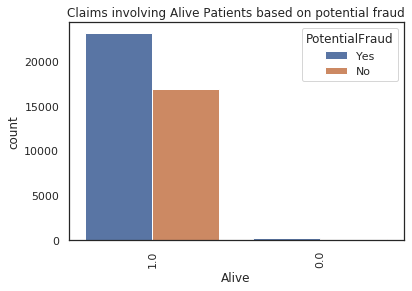

<Figure size 432x288 with 0 Axes>

In [101]:
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

sns.set
#sns.pairplot(plot, hue='PotentialFraud', height=2)
ax= sns.countplot(x='Alive',hue='PotentialFraud',data=plot
              ,order=plot.Alive.value_counts().iloc[:20].index)

    
plt.title('Claims involving Alive Patients based on potential fraud')
plt.xticks(rotation=90)
plt.show()

plt.savefig('TopAttendingphysiciansinvlovedinHealthcareFraud')


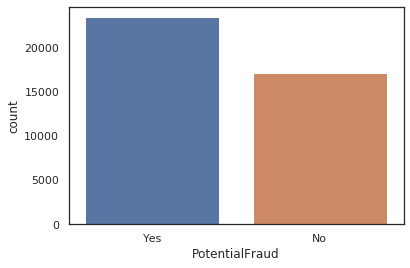

In [102]:
ax= sns.countplot(x='PotentialFraud', data = plot)

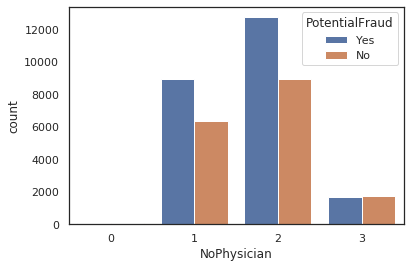

In [103]:
ax= sns.countplot(x='NoPhysician',hue='PotentialFraud', data = result_inpatient_benefit)

In [104]:
import plotly.express as px
fig = px.histogram(result_inpatient_benefit, x="InscClaimAmtReimbursed",
                   title='Histogram of Insurance claim Reimbursement', color="PotentialFraud"
                  )#, marginal="rug",hover_data=result_inpatient_benefit.columns)
fig.show()

In [105]:
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Histogram(
    x=result_inpatient_benefit.NoOfProc,
    #histnorm='percent',
    name='control', # name used in legClmProcedureCode_1end and hover labels
    xbins=dict( # bins used for histogram
        start=-4.0,
        end=6,
        size=0.5
    ),
    marker_color='#EB89B5',
    opacity=0.75
))
fig.update_layout(
    title_text='No of Procedures Performed per Beneficiary', # title of plot
    xaxis_title_text='No Of Procedure', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
#fig = px.histogram(result_inpatient_benefit, x="NoOfProc", color="PotentialFraud")
fig.show()

In [106]:
#fig = px.bar(result_inpatient_benefit, x='NoOfProc',
 #                  title='Histogram of No Of Proceedure with Potential Fraud Distribution', color="PotentialFraud"
  #                ,hover_data=result_inpatient_benefit.columns)
#fig.show()
import plotly.express as px

fig = px.histogram(result_inpatient_benefit, x ='NoOfProc',
                   title='Histogram of No Of Procedure with Potential Fraud Distribution', 
                        color="PotentialFraud")
fig.show()

In [108]:
fig = px.histogram(result_inpatient_benefit, x ="NoOfDiag",
                   title='Histogram of No of Diagnosis', color="PotentialFraud")


fig.show()

In [109]:
x = result_inpatient_benefit.PotentialFraud
y = result_inpatient_benefit.NoOfProc

fig = px.scatter(result_inpatient_benefit, x='NoOfProc', y="NoOfDiag", color="PotentialFraud",
                size='NoOfDiag', hover_data=['NoOfProc'])
fig.show()

In [110]:
import plotly.express as pxClmProcedureCode_1
fig = px.histogram(result_inpatient_benefit, x="DaysAdmitted",
                   title='Histogram of DaysAdmitted with Potential Fraud Distribution', color="PotentialFraud"
                  ,hover_data=result_inpatient_benefit.columns)
fig.show()

In [111]:
fig = px.scatter(result_inpatient_benefit, x='IPAnnualReimbursementAmt', y="IPAnnualDeductibleAmt", color="PotentialFraud",
                )
                 #size='IPAnnualReimbursementAmt', hover_data=['IPAnnualDeductibleAmt'])
fig.show()

In [112]:
import plotly.express as px
fig = px.histogram(result_inpatient_benefit, x="NoOfChronicCondition",
                   title='Histogram of Chronic Conditions with Potential Fraud Distribution', color="PotentialFraud"
                  ,hover_data=result_inpatient_benefit.columns)
fig.show()

In [ ]:
fig = px.scatter(result_inpatient_benefit, x='IPAnnualReimbursementAmt', y="InscClaimAmtReimbursed", color="PotentialFraud",
                )
                 #size='IPAnnualReimbursementAmt', hover_data=['IPAnnualDeductibleAmt'])
fig.show()

In [113]:
fig = px.box(result_inpatient_benefit, y="Age")
fig.show()

In [115]:
result_inpatient_benefit['ClmDiagnosisCode_1'] = result_inpatient_benefit['ClmDiagnosisCode_1'].astype('category')
fig = px.box(result_inpatient_benefit, x="PotentialFraud", y="Age")

fig.show()

In [116]:
fig = px.box(result_inpatient_benefit, x="PotentialFraud", y="IPAnnualReimbursementAmt")

fig.show()

In [117]:
fig = px.box(result_inpatient_benefit, x="NoOfProc", y="DaysAdmitted")

fig.show()

In [118]:
fig = px.box(result_inpatient_benefit, x="NoOfDiag", y="DaysAdmitted")

fig.show()

In [121]:
result_inpatient_benefit['ClmProcedureCode_1'].astype('category')
x = result_inpatient_benefit.groupby(['ClmProcedureCode_1']).count()[['BeneID']]
x = x.sort_values(by='BeneID',ascending = False)
z = x.head(20)
z

,BeneID
ClmProcedureCode_1,
9904.0,1137
8154.0,1021
66.0,893
3893.0,849
3995.0,805
4516.0,643
3722.0,581
8151.0,462
8872.0,409


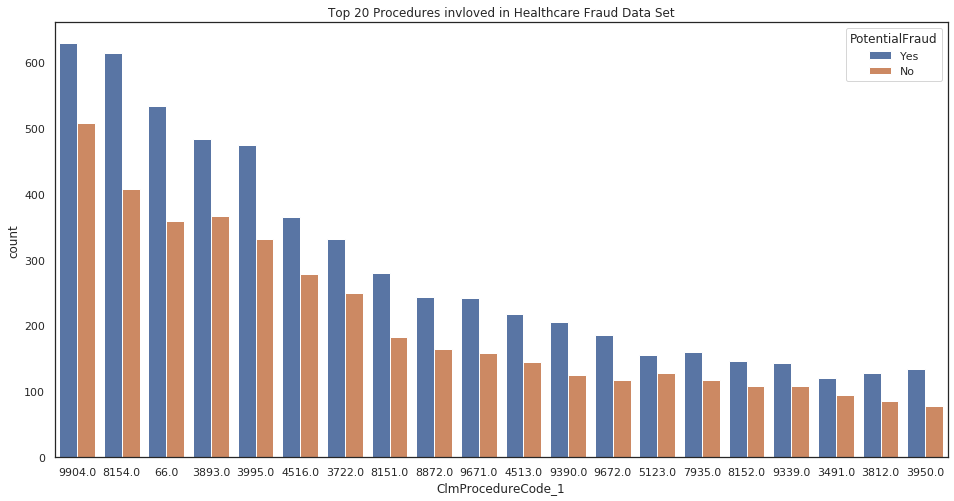

<Figure size 1152x576 with 0 Axes>

In [129]:
sns.set(rc={'figure.figsize':(16,8)},style='white')

ax=sns.countplot(x='ClmProcedureCode_1',hue='PotentialFraud',data=result_inpatient_benefit
              ,order=result_inpatient_benefit.ClmProcedureCode_1.value_counts().iloc[:20].index)

plt.title('Top 20 Procedures invloved in Healthcare Fraud Data Set')
    
plt.show()

plt.savefig('Top Procedures in Healthcare Fraud Data')

In [125]:
result_inpatient_benefit['ClmDiagnosisCode_1'].astype('category')
x = result_inpatient_benefit.groupby(['ClmDiagnosisCode_1']).count()[['BeneID']]
x = x.sort_values(by='BeneID',ascending = False)
z = x.head(20)
z

,BeneID
ClmDiagnosisCode_1,
486,1499
V5789,1158
41401,1088
49121,974
0389,945
5990,844
4280,825
42731,760
41071,718


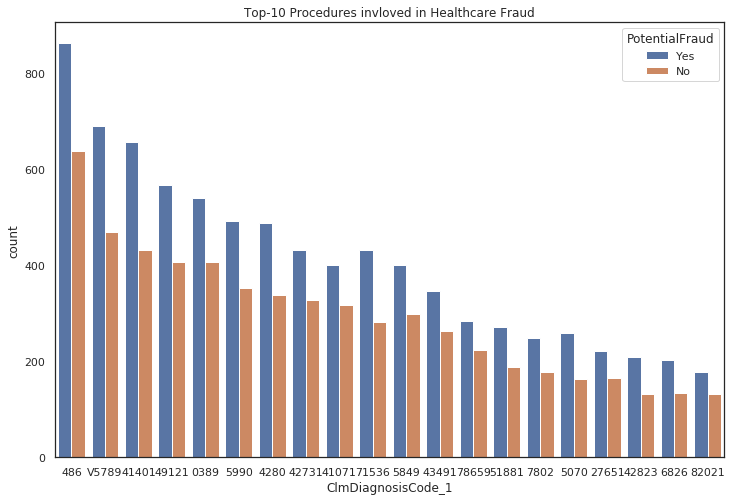

<Figure size 864x576 with 0 Axes>

In [126]:
sns.set(rc={'figure.figsize':(12,8)},style='white')

ax=sns.countplot(x='ClmDiagnosisCode_1',hue='PotentialFraud',data=result_inpatient_benefit
              ,order=result_inpatient_benefit.ClmDiagnosisCode_1.value_counts().iloc[:20].index)

plt.title('Top-10 Procedures invloved in Healthcare Fraud')
    
plt.show()

plt.savefig('TopDiagnosisinvlovedinHealthcareFraud')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36461 entries, 0 to 36460
Data columns (total 65 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   BeneID                           36461 non-null  object        
 1   ClaimID                          36461 non-null  object        
 2   ClaimStartDt                     36461 non-null  object        
 3   ClaimEndDt                       36461 non-null  object        
 4   Provider                         36461 non-null  object        
 5   InscClaimAmtReimbursed           36461 non-null  int64         
 6   AttendingPhysician               36364 non-null  object        
 7   OperatingPhysician               21476 non-null  object        
 8   OtherPhysician                   4278 non-null   object        
 9   AdmissionDt                      36461 non-null  datetime64[ns]
 10  ClmAdmitDiagnosisCode            36461 non-null  object   

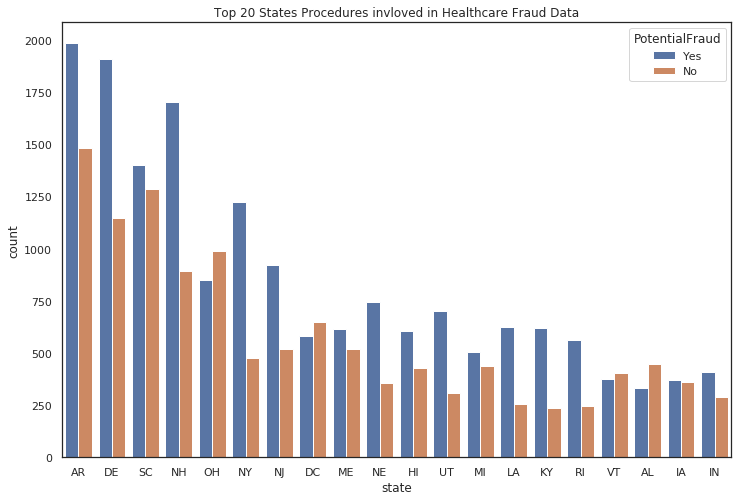

<Figure size 864x576 with 0 Axes>

In [140]:
sns.set(rc={'figure.figsize':(12,8)},style='white')

ax=sns.countplot(x="state",hue='PotentialFraud',data=result_inpatient_benefit
              ,order=result_inpatient_benefit["state"].value_counts().iloc[:20].index)

plt.title('Top 20 States Procedures invloved in Healthcare Fraud Data')
    
plt.show()

plt.savefig('Top States in Healthcare Fraud Data')




In [144]:
fig = px.scatter(result_inpatient_benefit, x='Age', y="IPAnnualDeductibleAmt", color="PotentialFraud",
                )
                 #size='IPAnnualReimbursementAmt', hover_data=['IPAnnualDeductibleAmt'])
fig.show()

In [147]:
fig = px.scatter(result_inpatient_benefit, x='Age', y="OPAnnualDeductibleAmt", color="PotentialFraud",
                )
                 #size='IPAnnualReimbursementAmt', hover_data=['IPAnnualDeductibleAmt'])
fig.show()


In [149]:
fig = px.scatter(result_inpatient_benefit, x='Age', y="DaysAdmitted",
                )
                 #size='IPAnnualReimbursementAmt', hover_data=['IPAnnualDeductibleAmt'])
fig.show()

In [162]:
fig = px.box(result_inpatient_benefit, x="NoOfDiag", y="Age")

fig.show()

In [164]:
fig = px.box(result_inpatient_benefit, x="NoOfProc", y="Age")

fig.show()